In [1]:
%load_ext autoreload
%autoreload 2

# Utils

In [2]:
# -----------
#  UTILS
import re
import numpy as np
def extract_time_deltas(string):
    # Regular expression to find all occurrences of TIME_DELTA= followed by a number
    pattern = r"TIME_DELTA=([\d\.]+)"
    # Find all matches and extract the numbers
    matches = re.findall(pattern, string)
    # Convert matches to integers
    time_deltas = [float(match) for match in matches]
    return time_deltas

def empty_folder(folder_path):
    for filename in os.listdir(folder_path):
        file_path = os.path.join(folder_path, filename)
        if os.path.isfile(file_path):
            os.remove(file_path)
        elif os.path.isdir(file_path):
            empty_folder(file_path)
            os.rmdir(file_path)
            
import re

def increment_time_deltas(string):
    # Regular expression to find all occurrences of TIME_DELTA= followed by a number
    pattern = r"TIME_DELTA=([\d\.]+)"
    
    # Function to increment the matched number
    def increment_match(match):
        # Get the current value as a float
        current_value = float(match.group(1))
        # Increment the value
        incremented_value = current_value + 1
        # Return the incremented value as a string, keeping the format
        return f"TIME_DELTA={incremented_value}"
    
    # Use re.sub with the increment function to replace all occurrences
    updated_string = re.sub(pattern, increment_match, string)
    
    return updated_string

import re

def increment_values(string,inc):
    # Regular expression to find all occurrences of TIME_DELTA=, NOTE_ON=, and NOTE_OFF= followed by a number
    pattern = r"(NOTE_ON|NOTE_OFF)=([\d\.]+)"
    
    # Function to increment the matched number
    def increment_match(match):
        # Get the prefix (TIME_DELTA, NOTE_ON, NOTE_OFF) and the current value as a float
        prefix = match.group(1)
        current_value = float(match.group(2))
        # Increment the value
        incremented_value = int(current_value + inc)
        # Return the incremented value with the prefix
        return f"{prefix}={incremented_value}"
    
    # Use re.sub with the increment function to replace all occurrences
    updated_string = re.sub(pattern, increment_match, string)
    
    return updated_string
import re

def find_highest_note_value(string):
    # Regular expression to find all occurrences of NOTE_ON=, and NOTE_OFF= followed by a number
    pattern = r"(NOTE_ON|NOTE_OFF)=([\d\.]+)"
    
    # Initialize the highest value
    highest_value = float('-inf')
    
    # Function to track the highest value
    def track_highest_value(match):
        nonlocal highest_value
        # Get the current value as a float
        current_value = float(match.group(2))
        
        # Track the highest value
        if current_value > highest_value:
            highest_value = current_value
        
        # Return the original match string (no modification)
        return match.group(0)
    
    # Use re.sub with the tracking function to scan all occurrences without modifying the string
    re.sub(pattern, track_highest_value, string)
    
    # Return the highest value found
    return int(highest_value)

# Example usage
def sum_time_deltas(input_string):
    # Use regular expression to find all occurrences of TIME_DELTA=(number)
    pattern = r'TIME_DELTA=(\d+)'
    matches = re.findall(pattern, input_string)
    
    # Convert matches to integers and sum them up
    time_deltas = [int(match) for match in matches]
    total_time_delta = sum(time_deltas)
    
    return total_time_delta
def get_music_timing(token_sequence, NOTE_LENGTH_16TH_120BPM=0.25 * 60 / 120, BAR_LENGTH_120BPM=16.0 ):
    if isinstance(token_sequence, str):
        token_sequence = token_sequence.split()

  
    first_note_start_time = None
    last_note_end_time = None
    current_time = 0
    current_bar_index = 0

    for token in token_sequence:
        if token == "TRACK_START":
            current_time = 0
            current_bar_index = 0
        
        elif token == "BAR_END":
            current_bar_index += 1
 
        elif token == "BAR_START":
            current_time = max(current_time,current_bar_index * BAR_LENGTH_120BPM)
            
        elif token.startswith('NOTE_ON'):
            token.split('=')[1]
            if first_note_start_time == None or current_time < first_note_start_time:
                first_note_start_time = current_time
                
                
        elif token.startswith('NOTE_OFF'):
            token.split('=')[1]
            if last_note_end_time == None or current_time > last_note_end_time:
                last_note_end_time = current_time
        
        elif token.startswith('TIME_DELTA'):
            current_time += int(token.split('=')[1]) 
            
     

    return first_note_start_time, last_note_end_time
fn = []
en = []
for line in content:
    first_note_start_time, last_note_end_time = get_music_timing(line)
    fn.append(first_note_start_time)
    en.append(last_note_end_time)

def return_only_real(line):
    tracks = line.split('TRACK_START') 
    new_line = tracks[0]
    for track in tracks[1:]:
        if 'NOTE_ON' in track:
            new_line += 'TRACK_START' + track
            
    return new_line

def durations(string):
    durations = []
    fi = 'BAR_START ' + 'BAR_START '.join(string.split('BAR_START ')[1:])

    li = 'BAR_END '.join(fi.split('BAR_END ')[:-1]) + 'BAR_END'

    for bar in li.split('BAR_START'):
        durations.append(np.sum(extract_time_deltas(bar)))
        
    return durations,li.split('BAR_START')

def count_bars(string):
    tracks = string.split('TRACK_START')[1:]
    counting = []
    for track in tracks:
        counting.append(len(('TRACK_START' + track).split('BAR_START')) - 1)
    return counting

Output String: Some text TIME_DELTA=1.5 more text NOTE_ON=2 and NOTE_OFF=4 and TIME_DELTA=3.2
Highest Value: 120


# Extraction

## Folder's 

In [3]:
from extract import extract_folder_to_txt, chunks_division,extract_file_to_txt
import os

from_folder = 'Finalix'
destination_folder = 'op'


## Extraction

In [ ]:
from extract import extract_folder_to_txt, chunks_division
import os


empty_folder(destination_folder)
chunks_division(from_folder,destination_folder,8,3000,4,with_bpm=False,chunks_per_music=4)

## To_One_TXT

In [ ]:
## Iterate on a folder's txt and put each txt in a line of a final txt

## Remove Duplicates

In [ ]:
## Remove Dup

# Some Quick checks

### First note & Last note

In [ ]:


display_txt(content[1],4,120)
print(get_music_timing(content[1]))

### Bar's Anomaly Check

In [16]:
from display import display_txt

with open('output_nodup.txt') as f:
    content = f.readlines()
anom = 0
nom = 0
for line in (content):
    for track in line.split('TRACK_START')[1:]:
        
        if track.count('BAR_START') > 8:
            anom += 1
            # display_txt('TRACK_START ' +track,4,120)
            # break
        else:
            nom += 1
print(anom,nom)        


0 134069


### Random display

In [29]:
import random 

content = open('Augmented_FLP.txt').readlines()
print(len(content))
from display import display_txt
random_elements = random.sample(content, 10) 
for line in random_elements:
    display_txt(line,4,120)
    



443184
PIECE_START GENRE=POP TRACK_START INST=1 BAR_START NOTE_ON=32 NOTE_ON=47 TIME_DELTA=1 NOTE_OFF=32 NOTE_OFF=47 NOTE_ON=39 TIME_DELTA=1 NOTE_OFF=39 NOTE_ON=51 TIME_DELTA=1 NOTE_OFF=51 NOTE_ON=47 TIME_DELTA=1 NOTE_OFF=47 NOTE_ON=32 NOTE_ON=47 TIME_DELTA=1 NOTE_OFF=32 NOTE_OFF=47 TIME_DELTA=1 NOTE_ON=51 TIME_DELTA=1 NOTE_OFF=51 NOTE_ON=47 TIME_DELTA=1 NOTE_OFF=47 NOTE_ON=47 NOTE_ON=35 TIME_DELTA=1 NOTE_OFF=47 NOTE_OFF=35 NOTE_ON=42 TIME_DELTA=1 NOTE_OFF=42 NOTE_ON=51 TIME_DELTA=1 NOTE_OFF=51 NOTE_ON=47 TIME_DELTA=1 NOTE_OFF=47 BAR_END BAR_START NOTE_ON=32 NOTE_ON=47 TIME_DELTA=1 NOTE_OFF=32 NOTE_OFF=47 NOTE_ON=39 TIME_DELTA=1 NOTE_OFF=39 NOTE_ON=51 TIME_DELTA=1 NOTE_OFF=51 NOTE_ON=47 TIME_DELTA=1 NOTE_OFF=47 NOTE_ON=39 NOTE_ON=32 NOTE_ON=47 TIME_DELTA=1 NOTE_OFF=39 NOTE_OFF=32 NOTE_OFF=47 NOTE_ON=39 TIME_DELTA=1 NOTE_OFF=39 NOTE_ON=51 TIME_DELTA=1 NOTE_OFF=51 NOTE_ON=47 TIME_DELTA=1 NOTE_OFF=47 NOTE_ON=35 TIME_DELTA=1 NOTE_OFF=35 NOTE_ON=42 TIME_DELTA=1 NOTE_OFF=42 NOTE_ON=51 TIME_D

Loading BokehJS ...

PIECE_START GENRE=POP TRACK_START INST=1 BAR_START NOTE_ON=82 NOTE_ON=70 NOTE_ON=54 TIME_DELTA=4 NOTE_OFF=82 NOTE_OFF=70 NOTE_OFF=54 NOTE_ON=77 NOTE_ON=73 NOTE_ON=82 NOTE_ON=54 NOTE_ON=70 TIME_DELTA=3 NOTE_ON=68 TIME_DELTA=1 NOTE_OFF=77 NOTE_OFF=73 NOTE_OFF=82 NOTE_OFF=70 NOTE_OFF=68 NOTE_ON=70 TIME_DELTA=1 NOTE_ON=68 TIME_DELTA=1 NOTE_OFF=54 NOTE_OFF=70 NOTE_OFF=68 NOTE_ON=77 NOTE_ON=73 NOTE_ON=82 NOTE_ON=54 NOTE_ON=70 TIME_DELTA=3 NOTE_OFF=77 NOTE_OFF=73 NOTE_OFF=82 NOTE_OFF=54 NOTE_OFF=70 TIME_DELTA=1 NOTE_ON=77 NOTE_ON=73 NOTE_ON=82 NOTE_ON=70 NOTE_ON=54 BAR_END BAR_START NOTE_OFF=77 NOTE_OFF=73 NOTE_OFF=82 NOTE_OFF=70 NOTE_OFF=54 NOTE_ON=79 NOTE_ON=70 NOTE_ON=51 TIME_DELTA=4 NOTE_OFF=79 NOTE_OFF=70 NOTE_OFF=51 NOTE_ON=75 NOTE_ON=79 NOTE_ON=70 NOTE_ON=51 TIME_DELTA=3 NOTE_ON=68 TIME_DELTA=1 NOTE_OFF=75 NOTE_OFF=79 NOTE_OFF=70 NOTE_OFF=68 NOTE_ON=70 TIME_DELTA=1 NOTE_OFF=70 NOTE_ON=68 TIME_DELTA=1 NOTE_OFF=51 NOTE_OFF=68 NOTE_ON=75 NOTE_ON=79 NOTE_ON=51 NOTE_ON=70 TIME_DELTA=3 NOTE_

Loading BokehJS ...

PIECE_START GENRE=HIPHOP TRACK_START INST=1 BAR_START TIME_DELTA=8 NOTE_ON=62 BAR_END BAR_START NOTE_OFF=62 NOTE_ON=60 BAR_END BAR_START NOTE_OFF=60 BAR_END BAR_START NOTE_ON=65 BAR_END BAR_START NOTE_OFF=65 BAR_END TRACK_END TRACK_START INST=1 BAR_START NOTE_ON=36 TIME_DELTA=2 NOTE_OFF=36 NOTE_ON=43 TIME_DELTA=1 NOTE_OFF=43 TIME_DELTA=1 NOTE_ON=50 TIME_DELTA=1 NOTE_ON=51 TIME_DELTA=1 NOTE_OFF=50 NOTE_OFF=51 NOTE_ON=55 TIME_DELTA=1 NOTE_OFF=55 TIME_DELTA=1 NOTE_ON=60 TIME_DELTA=1 NOTE_OFF=60 TIME_DELTA=1 NOTE_ON=55 TIME_DELTA=1 NOTE_OFF=55 TIME_DELTA=1 NOTE_ON=50 NOTE_ON=51 TIME_DELTA=1 NOTE_OFF=50 TIME_DELTA=1 NOTE_OFF=51 NOTE_ON=50 BAR_END BAR_START NOTE_OFF=50 NOTE_ON=36 TIME_DELTA=2 NOTE_OFF=36 NOTE_ON=43 TIME_DELTA=1 NOTE_OFF=43 TIME_DELTA=1 NOTE_ON=50 TIME_DELTA=1 NOTE_ON=51 TIME_DELTA=1 NOTE_OFF=50 NOTE_OFF=51 NOTE_ON=55 TIME_DELTA=1 NOTE_OFF=55 TIME_DELTA=1 NOTE_ON=60 TIME_DELTA=1 NOTE_OFF=60 TIME_DELTA=1 NOTE_ON=55 TIME_DELTA=1 NOTE_OFF=55 TIME_DELTA=1 NOTE_ON=39 NOTE_ON=55 TI

Loading BokehJS ...

PIECE_START GENRE=HIPHOP TRACK_START INST=1 BAR_START NOTE_ON=67 NOTE_ON=60 NOTE_ON=48 NOTE_ON=53 NOTE_ON=79 TIME_DELTA=1 NOTE_OFF=67 NOTE_OFF=60 NOTE_OFF=48 NOTE_OFF=53 NOTE_OFF=79 NOTE_ON=65 NOTE_ON=50 NOTE_ON=77 TIME_DELTA=1 NOTE_OFF=65 NOTE_OFF=50 NOTE_OFF=77 NOTE_ON=51 NOTE_ON=63 NOTE_ON=75 NOTE_ON=56 NOTE_ON=60 TIME_DELTA=4 NOTE_OFF=51 NOTE_OFF=63 NOTE_OFF=75 NOTE_OFF=56 NOTE_OFF=60 NOTE_ON=65 NOTE_ON=60 NOTE_ON=56 NOTE_ON=53 NOTE_ON=77 TIME_DELTA=1 NOTE_OFF=65 NOTE_OFF=60 NOTE_OFF=56 NOTE_OFF=53 NOTE_OFF=77 NOTE_ON=63 NOTE_ON=75 NOTE_ON=54 TIME_DELTA=1 NOTE_OFF=63 NOTE_OFF=75 NOTE_OFF=54 NOTE_ON=62 NOTE_ON=55 NOTE_ON=50 NOTE_ON=74 TIME_DELTA=6 NOTE_OFF=62 NOTE_OFF=55 NOTE_OFF=50 NOTE_OFF=74 BAR_END BAR_START NOTE_ON=63 NOTE_ON=60 NOTE_ON=55 NOTE_ON=51 NOTE_ON=75 TIME_DELTA=1 NOTE_OFF=63 NOTE_OFF=60 NOTE_OFF=55 NOTE_OFF=51 NOTE_OFF=75 NOTE_ON=62 NOTE_ON=58 NOTE_ON=55 NOTE_ON=50 NOTE_ON=74 TIME_DELTA=1 NOTE_OFF=62 NOTE_OFF=58 NOTE_OFF=55 NOTE_OFF=50 NOTE_OFF=74 NOTE_ON=60 NOTE_ON=

Loading BokehJS ...

PIECE_START GENRE=EDM TRACK_START INST=33 BAR_START TIME_DELTA=1 NOTE_ON=57 NOTE_ON=61 NOTE_ON=66 TIME_DELTA=2 NOTE_OFF=57 NOTE_OFF=61 NOTE_OFF=66 NOTE_ON=57 NOTE_ON=61 NOTE_ON=66 TIME_DELTA=2 NOTE_OFF=57 NOTE_OFF=61 NOTE_OFF=66 TIME_DELTA=1 NOTE_ON=58 NOTE_ON=62 NOTE_ON=67 TIME_DELTA=2 NOTE_OFF=58 NOTE_OFF=62 NOTE_OFF=67 TIME_DELTA=3 NOTE_ON=57 NOTE_ON=61 NOTE_ON=66 TIME_DELTA=2 NOTE_OFF=57 NOTE_OFF=61 NOTE_OFF=66 BAR_END BAR_START TIME_DELTA=1 NOTE_ON=57 NOTE_ON=61 NOTE_ON=66 TIME_DELTA=2 NOTE_OFF=57 NOTE_OFF=61 NOTE_OFF=66 NOTE_ON=57 NOTE_ON=61 NOTE_ON=66 TIME_DELTA=2 NOTE_OFF=57 NOTE_OFF=61 NOTE_OFF=66 TIME_DELTA=1 NOTE_ON=58 NOTE_ON=62 NOTE_ON=67 TIME_DELTA=2 NOTE_OFF=58 NOTE_OFF=62 NOTE_OFF=67 TIME_DELTA=3 NOTE_ON=57 NOTE_ON=61 NOTE_ON=66 TIME_DELTA=2 NOTE_OFF=57 NOTE_OFF=61 NOTE_OFF=66 TIME_DELTA=2 NOTE_ON=57 NOTE_ON=61 NOTE_ON=66 BAR_END BAR_START TIME_DELTA=1 NOTE_OFF=57 NOTE_OFF=61 NOTE_OFF=66 NOTE_ON=57 NOTE_ON=61 NOTE_ON=66 TIME_DELTA=2 NOTE_OFF=57 NOTE_OFF=61 NOTE_OFF=66 N

Loading BokehJS ...

PIECE_START GENRE=POP TRACK_START INST=3 BAR_START NOTE_ON=38 NOTE_ON=62 NOTE_ON=53 NOTE_ON=50 NOTE_ON=65 NOTE_ON=57 NOTE_ON=26 TIME_DELTA=12 NOTE_OFF=38 NOTE_OFF=62 NOTE_OFF=53 NOTE_OFF=50 NOTE_OFF=65 NOTE_OFF=57 NOTE_OFF=26 NOTE_ON=43 NOTE_ON=67 NOTE_ON=58 NOTE_ON=55 NOTE_ON=70 NOTE_ON=62 NOTE_ON=31 BAR_END BAR_START TIME_DELTA=8 NOTE_OFF=43 NOTE_OFF=67 NOTE_OFF=58 NOTE_OFF=55 NOTE_OFF=70 NOTE_OFF=62 NOTE_OFF=31 NOTE_ON=33 NOTE_ON=65 NOTE_ON=57 NOTE_ON=45 NOTE_ON=60 NOTE_ON=69 NOTE_ON=72 BAR_END BAR_START TIME_DELTA=8 NOTE_OFF=33 NOTE_OFF=65 NOTE_OFF=57 NOTE_OFF=45 NOTE_OFF=60 NOTE_OFF=69 NOTE_OFF=72 NOTE_ON=65 NOTE_ON=57 NOTE_ON=60 NOTE_ON=45 NOTE_ON=72 NOTE_ON=69 NOTE_ON=33 TIME_DELTA=1 NOTE_OFF=65 NOTE_OFF=57 NOTE_OFF=60 NOTE_OFF=45 NOTE_OFF=72 NOTE_OFF=69 NOTE_OFF=33 TIME_DELTA=1 NOTE_ON=69 NOTE_ON=72 NOTE_ON=45 NOTE_ON=60 NOTE_ON=57 NOTE_ON=65 NOTE_ON=33 TIME_DELTA=1 NOTE_OFF=69 NOTE_OFF=72 NOTE_OFF=45 NOTE_OFF=60 NOTE_OFF=57 NOTE_OFF=65 NOTE_OFF=33 BAR_END BAR_START TIME_DELTA=

Loading BokehJS ...

PIECE_START GENRE=EDM TRACK_START INST=39 BAR_START NOTE_ON=61 TIME_DELTA=1 NOTE_OFF=61 NOTE_ON=61 TIME_DELTA=2 NOTE_OFF=61 NOTE_ON=61 TIME_DELTA=1 NOTE_OFF=61 NOTE_ON=61 TIME_DELTA=1 NOTE_OFF=61 NOTE_ON=61 TIME_DELTA=2 NOTE_OFF=61 NOTE_ON=61 TIME_DELTA=1 NOTE_OFF=61 NOTE_ON=61 TIME_DELTA=1 NOTE_OFF=61 NOTE_ON=61 TIME_DELTA=2 NOTE_OFF=61 NOTE_ON=61 TIME_DELTA=1 NOTE_OFF=61 BAR_END TRACK_END TRACK_START INST=39 BAR_START BAR_END BAR_START NOTE_ON=61 TIME_DELTA=1 NOTE_OFF=61 NOTE_ON=61 TIME_DELTA=2 NOTE_OFF=61 NOTE_ON=61 TIME_DELTA=1 NOTE_OFF=61 NOTE_ON=61 TIME_DELTA=1 NOTE_OFF=61 NOTE_ON=61 TIME_DELTA=2 NOTE_OFF=61 NOTE_ON=61 TIME_DELTA=1 NOTE_OFF=61 NOTE_ON=61 TIME_DELTA=1 NOTE_OFF=61 NOTE_ON=61 TIME_DELTA=2 NOTE_OFF=61 NOTE_ON=61 TIME_DELTA=1 NOTE_OFF=61 BAR_END TRACK_END TRACK_START INST=39 BAR_START BAR_END BAR_START TIME_DELTA=12 NOTE_ON=61 TIME_DELTA=1 NOTE_OFF=61 NOTE_ON=61 TIME_DELTA=2 NOTE_OFF=61 NOTE_ON=61 BAR_END BAR_START NOTE_OFF=61 NOTE_ON=61 TIME_DELTA=1 NOTE_OFF=61 NOTE_

Loading BokehJS ...

PIECE_START GENRE=TRAP TRACK_START INST=115 BAR_START NOTE_ON=54 TIME_DELTA=2 NOTE_OFF=54 TIME_DELTA=8 NOTE_ON=58 TIME_DELTA=2 NOTE_OFF=58 BAR_END BAR_START NOTE_ON=58 TIME_DELTA=2 NOTE_OFF=58 NOTE_ON=58 TIME_DELTA=2 NOTE_OFF=58 TIME_DELTA=5 NOTE_ON=53 TIME_DELTA=1 NOTE_OFF=53 NOTE_ON=58 TIME_DELTA=2 NOTE_OFF=58 TIME_DELTA=1 NOTE_ON=53 TIME_DELTA=2 NOTE_OFF=53 BAR_END TRACK_END TRACK_START INST=25 BAR_START TIME_DELTA=2 NOTE_ON=77 TIME_DELTA=1 NOTE_OFF=77 NOTE_ON=75 TIME_DELTA=1 NOTE_OFF=75 NOTE_ON=73 TIME_DELTA=2 NOTE_OFF=73 TIME_DELTA=6 NOTE_ON=22 NOTE_ON=72 TIME_DELTA=2 NOTE_OFF=22 NOTE_OFF=72 TIME_DELTA=1 NOTE_ON=72 BAR_END BAR_START NOTE_OFF=72 NOTE_ON=73 TIME_DELTA=2 NOTE_OFF=73 NOTE_ON=65 TIME_DELTA=4 NOTE_OFF=65 NOTE_ON=61 TIME_DELTA=1 NOTE_OFF=61 NOTE_ON=65 TIME_DELTA=1 NOTE_OFF=65 NOTE_ON=66 TIME_DELTA=1 NOTE_ON=22 TIME_DELTA=1 NOTE_OFF=66 NOTE_ON=58 TIME_DELTA=1 NOTE_OFF=22 BAR_END BAR_START NOTE_OFF=58 BAR_END TRACK_END TRACK_START INST=3 BAR_START NOTE_ON=54 NOTE_ON=42 NOT

Loading BokehJS ...

PIECE_START GENRE=TRAP TRACK_START INST=97 BAR_START NOTE_ON=68 TIME_DELTA=4 NOTE_OFF=68 TIME_DELTA=4 NOTE_ON=63 TIME_DELTA=4 NOTE_OFF=63 BAR_END BAR_START NOTE_ON=68 TIME_DELTA=4 NOTE_OFF=68 TIME_DELTA=4 NOTE_ON=72 TIME_DELTA=6 NOTE_OFF=72 BAR_END BAR_START NOTE_ON=68 TIME_DELTA=4 NOTE_OFF=68 TIME_DELTA=4 NOTE_ON=63 TIME_DELTA=4 NOTE_OFF=63 BAR_END BAR_START NOTE_ON=68 TIME_DELTA=4 NOTE_OFF=68 TIME_DELTA=4 NOTE_ON=72 TIME_DELTA=6 NOTE_OFF=72 BAR_END BAR_START NOTE_ON=68 TIME_DELTA=4 NOTE_OFF=68 TIME_DELTA=4 NOTE_ON=63 TIME_DELTA=4 NOTE_OFF=63 BAR_END BAR_START NOTE_ON=68 TIME_DELTA=4 NOTE_OFF=68 TIME_DELTA=4 NOTE_ON=72 TIME_DELTA=6 NOTE_OFF=72 BAR_END TRACK_END TRACK_START INST=1 BAR_START BAR_END BAR_START BAR_END BAR_START BAR_END BAR_START BAR_END BAR_START BAR_END BAR_START BAR_END BAR_START TIME_DELTA=4 NOTE_ON=68 TIME_DELTA=4 NOTE_OFF=68 BAR_END TRACK_END TRACK_START INST=97 BAR_START BAR_END BAR_START BAR_END BAR_START BAR_END BAR_START BAR_END BAR_START BAR_END BAR_START BAR_E

Loading BokehJS ...

PIECE_START GENRE=TRAP TRACK_START INST=15 BAR_START NOTE_ON=74 NOTE_ON=67 NOTE_ON=62 NOTE_ON=55 NOTE_ON=43 TIME_DELTA=4 NOTE_OFF=74 NOTE_OFF=62 NOTE_ON=75 NOTE_ON=63 TIME_DELTA=2 NOTE_OFF=67 NOTE_OFF=55 NOTE_ON=67 NOTE_ON=55 TIME_DELTA=2 NOTE_OFF=75 NOTE_OFF=63 NOTE_ON=74 NOTE_ON=58 TIME_DELTA=4 NOTE_OFF=43 NOTE_OFF=67 NOTE_OFF=55 NOTE_OFF=74 NOTE_OFF=58 NOTE_ON=74 NOTE_ON=69 NOTE_ON=67 NOTE_ON=55 NOTE_ON=43 BAR_END BAR_START NOTE_OFF=74 NOTE_OFF=69 NOTE_ON=74 NOTE_ON=62 TIME_DELTA=2 NOTE_OFF=67 NOTE_ON=67 TIME_DELTA=2 NOTE_OFF=55 NOTE_OFF=74 NOTE_OFF=62 NOTE_ON=75 NOTE_ON=63 NOTE_ON=57 TIME_DELTA=4 NOTE_OFF=43 NOTE_OFF=67 NOTE_OFF=75 NOTE_OFF=63 NOTE_ON=72 NOTE_ON=67 NOTE_ON=60 NOTE_ON=43 TIME_DELTA=2 NOTE_OFF=57 NOTE_ON=57 TIME_DELTA=2 NOTE_OFF=72 NOTE_OFF=60 NOTE_ON=72 NOTE_ON=69 TIME_DELTA=2 NOTE_OFF=67 NOTE_ON=67 BAR_END BAR_START NOTE_OFF=43 NOTE_OFF=57 NOTE_OFF=72 NOTE_OFF=69 NOTE_OFF=67 NOTE_ON=74 NOTE_ON=67 NOTE_ON=62 NOTE_ON=55 NOTE_ON=43 TIME_DELTA=4 NOTE_OFF=74 NOTE_OFF=62

Loading BokehJS ...

### ((Temporary)) TimeDelta=0 removing

In [14]:
import os

content = open('last.txt').readlines()
print(len(content))
new_lines = []

for line in content:
    new_lines.append(line.replace('TIME_DELTA=0 ',' ').replace('  ',' '))
    
print(len(new_lines))

with open('last_re.txt', 'a') as file:
    for package in new_lines:
        file.write(package )

24038
24038


### Counting Bars

In [21]:

content = open('last_re.txt').readlines()

for idx,line in enumerate(content):
    if any(value > 8 for value in count_bars(line)):
        print(count_bars(line),line.split('TRACK_START')[-1])


### Bar's Durations' check

In [22]:


with open('last_re.txt') as f:
    content = f.readlines()
    
    
for line in content:
    if any(value > 16 for value in durations(line)[0]):
        print(durations(line)[0])



# Augmentation

In [50]:
with open('output_nodup_final.txt') as f:
    content = f.readlines()

augmented_content = []
for el in content:
    if find_highest_note_value(el) < 100:
        for i in range(12):
            augmented_content.append(increment_values(el,i))
            augmented_content.append(increment_values(el,-1-i))
            
with open('output_augmented_final.txt', 'a') as f:
    for item in augmented_content:
        f.write("%s" % item)


# Analysis

## keys

In [28]:
from tqdm import tqdm
genres = {}
with open('output.txt') as f:
    content = f.readlines()
    
for line in content:
    genre = line.split()[1].split('=')[1]
    if genre not in genres:
        genres[genre] = []
    genres[genre].append(line)

In [29]:
genres_keys = {genre : [] for genre in genres.keys()}

In [24]:
final_genre = {genre : [] for genre in genres_keys.keys()}
for genre in genres_keys:
    print(genre)
    for key_ in (genres_keys[genre]):
        final_genre[genre].append(str(key_.tonic.name) + ' ' + str(key_.mode))
        

HIPHOP
TRAP
AFRO
EDM
RNB
FUNK
POP
DRILL
HOUSE
BOOMBAP
OTHER
D&B
REGGAETON
CINEMATIC
ELECTRONIC
JAZZ


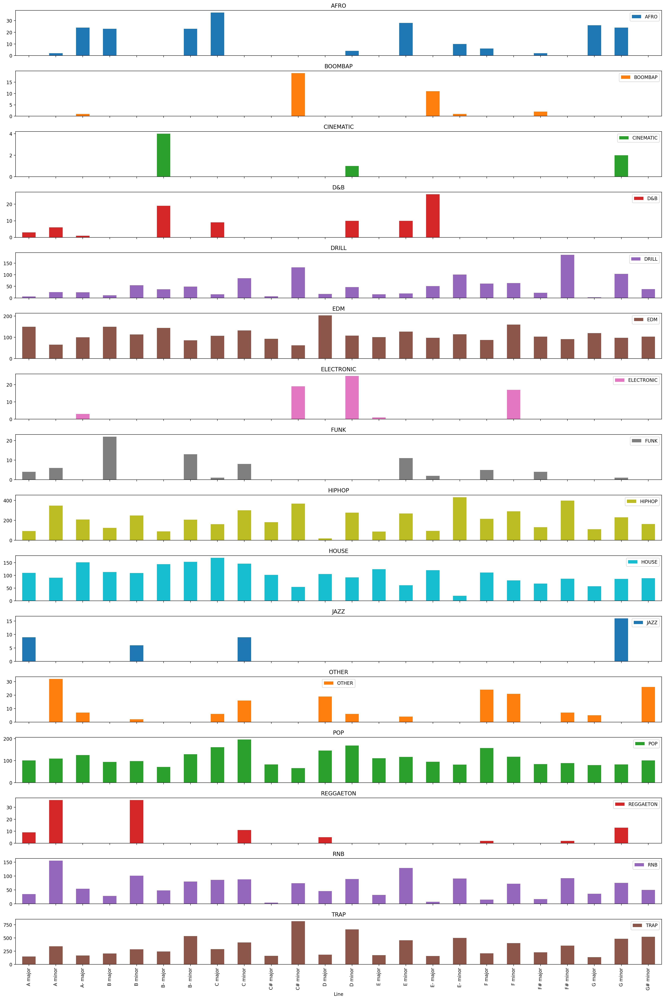

In [33]:
# Convert dictionary to a DataFrame
df = pd.DataFrame([(genre, line) for genre, lines in final_genre.items() for line in lines], columns=['Genre', 'Key - Mode'])

# Count occurrences of each line per genre
line_counts = df.groupby(['Line', 'Genre']).size().unstack(fill_value=0)

# Plot bar charts
line_counts.plot(kind='bar', subplots=True, layout=(len(line_counts.columns), 1), figsize=(20,30), legend=True)
plt.tight_layout()
plt.show()

## nb_tracks

In [18]:
import numpy as np




bools = []
with open('output_nodup.txt') as f:
    content = f.readlines()
    
for line in content:
    if line == return_only_real(line):
        bools.append(True)
        
print(np.sum(np.array(bools))/len(bools))

1.0


In [19]:
from tqdm import tqdm
genres = {}
with open('output_nodup.txt') as f:
    content = f.readlines()
    
for line in content:
    genre = line.split()[1].split('=')[1]
    if genre not in genres:
        genres[genre] = []
    genres[genre].append(line)

In [20]:
from tqdm import tqdm
genres_nb_tracks = {genre : [] for genre in genres.keys()}

keys = []
for genre in genres:
    for line in tqdm(genres[genre]):
        nb_tracks = len(line.split('TRACK_START'))
        genres_nb_tracks[genre].append(nb_tracks)
    


100%|██████████| 25/25 [00:00<00:00, 187916.85it/s]


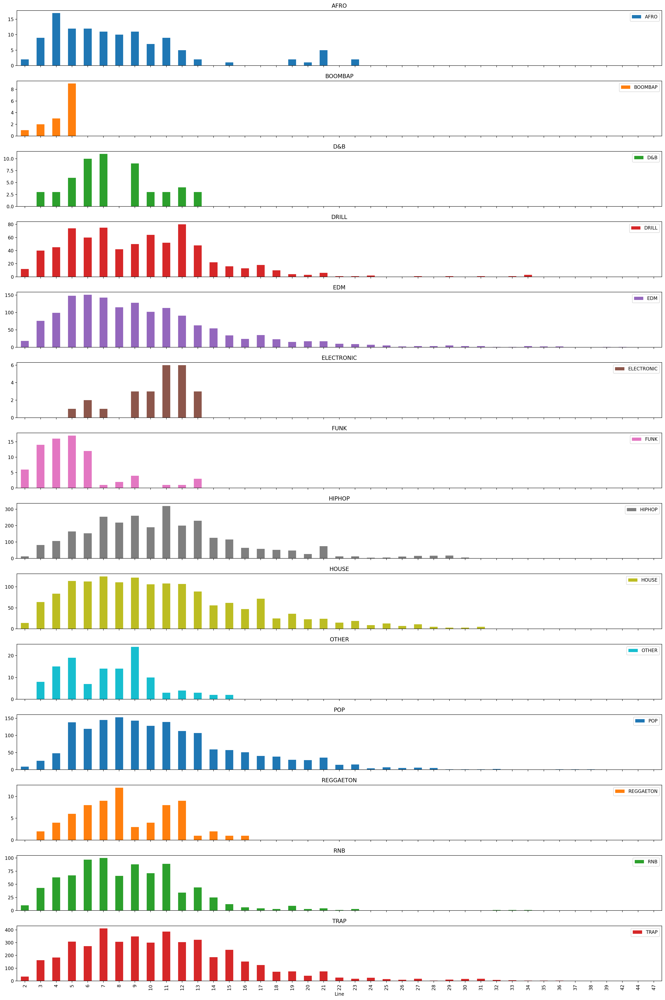

In [23]:
import pandas as pd
import matplotlib.pyplot as plt
df = pd.DataFrame([(genre, line) for genre, lines in genres_nb_tracks.items() for line in lines], columns=['Genre', 'Line'])

# Count occurrences of each line per genre
line_counts = df.groupby(['Line', 'Genre']).size().unstack(fill_value=0)

# Plot bar charts
line_counts.plot(kind='bar', subplots=True, layout=(len(line_counts.columns), 1), figsize=(20,30), legend=True)
plt.tight_layout()
plt.show()

## nb_notes_per_track

In [24]:
from tqdm import tqdm
genres = {}
with open('output_nodup.txt') as f:
    content = f.readlines()
    
for line in content:
    genre = line.split()[1].split('=')[1]
    if genre not in genres:
        genres[genre] = []
    genres[genre].append(line)

In [25]:
from tqdm import tqdm
import numpy as np
import pandas as pd
genres_nb_npt = {genre : [] for genre in genres.keys()}

keys = []
for genre in genres:
    for line in tqdm(genres[genre]):
        nb_tracks = len(line.split('TRACK_START'))
        mini_nb = []
        for track in line.split('TRACK_START')[1:]:
            mini_nb.append(track.count('NOTE_ON'))
        genres_nb_npt[genre].append(np.mean(mini_nb))
    


100%|██████████| 25/25 [00:00<00:00, 48077.76it/s]


In [26]:
df = pd.DataFrame([(genre, value) for genre, values in genres_nb_npt.items() for value in values], columns=['Genre', 'Value'])

df

,Genre,Value
0,HIPHOP,21.833333
1,HIPHOP,12.857143
2,HIPHOP,6.000000
3,HIPHOP,22.000000
4,HIPHOP,13.166667
...,...,...
14209,ELECTRONIC,10.200000
14210,ELECTRONIC,9.100000
14211,ELECTRONIC,10.250000
14212,ELECTRONIC,10.000000


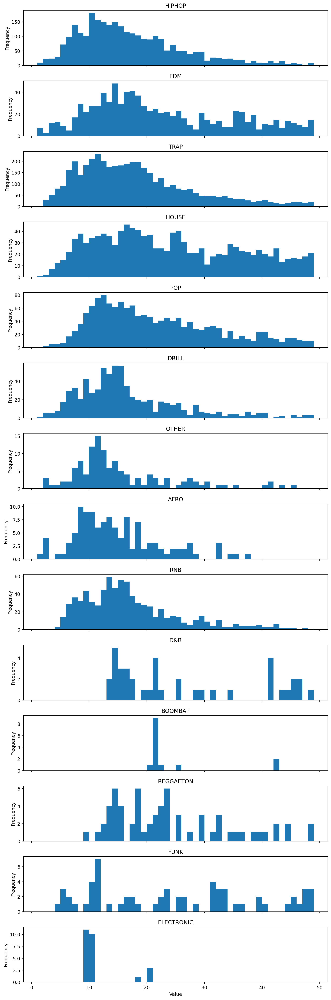

In [27]:
import pandas as pd
import matplotlib.pyplot as plt


# Convert dictionary to a DataFrame
df = pd.DataFrame([(genre, value) for genre, values in genres_nb_npt.items() for value in values], columns=['Genre', 'Value'])

# Plot histograms
genres = df['Genre'].unique()
num_genres = len(genres)
fig, axes = plt.subplots(num_genres, 1, figsize=(10, 30), sharex=True)

for i, genre in enumerate(genres):
    ax = axes[i]
    df[df['Genre'] == genre]['Value'].plot(kind='hist', bins=range(int(df['Value'].min()), 50), ax=ax, legend=False, title=genre)
    #df[df['Genre'] == genre]['Value'].hist(ax=ax)
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')

plt.tight_layout()
plt.show()

## unique notes

In [40]:
from tqdm import tqdm
genres = {}
with open('output.txt') as f:
    content = f.readlines()
    
for line in content:
    genre = line.split()[1].split('=')[1]
    if genre not in genres:
        genres[genre] = []
    genres[genre].append(line)
    


In [42]:

genres_nb_unique_notes = {genre : [] for genre in genres.keys()}
coco = 0
for genre in genres:
    for line in tqdm(genres[genre]):
        nb_tracks = len(line.split('TRACK_START'))
        unique_notes_per_track = []
        for track in line.split('TRACK_START')[1:]:
            notes = set()
            for note in track.split():
                if note.startswith('NOTE_ON='):
                    note_value = int(note.split('=')[1])
                    notes.add(note_value)
            unique_notes_per_track.append(len(notes))
            if len(notes) == 1:
                coco +=1
        genres_nb_unique_notes[genre].append(np.mean(unique_notes_per_track))
        
print(coco)

100%|██████████| 40/40 [00:00<00:00, 6356.21it/s]

28954


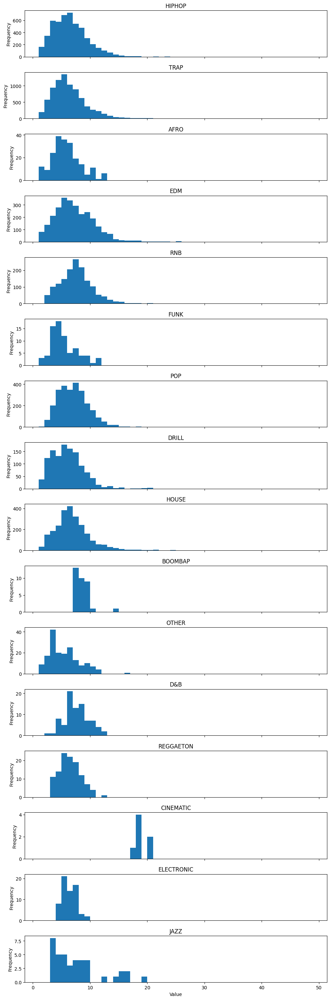

In [20]:
import pandas as pd
import matplotlib.pyplot as plt


# Convert dictionary to a DataFrame
df = pd.DataFrame([(genre, value) for genre, values in genres_nb_unique_notes.items() for value in values], columns=['Genre', 'Value'])

# Plot histograms
genres = df['Genre'].unique()
num_genres = len(genres)
fig, axes = plt.subplots(num_genres, 1, figsize=(10, 30), sharex=True)

for i, genre in enumerate(genres):
    ax = axes[i]
    df[df['Genre'] == genre]['Value'].plot(kind='hist', bins=range(int(df['Value'].min()), 50), ax=ax, legend=False, title=genre)
    #df[df['Genre'] == genre]['Value'].hist(ax=ax)
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')

plt.tight_layout()
plt.show()

In [44]:
from tqdm import tqdm
genres = {}
with open('output.txt') as f:
    content = f.readlines()
    
for line in content:
    genre = line.split()[1].split('=')[1]
    if genre not in genres:
        genres[genre] = []
    genres[genre].append(line)
    

one_note = {genre : [0,0] for genre in genres.keys()}
for genre in genres:
    for line in tqdm(genres[genre]):
        nb_tracks = len(line.split('TRACK_START'))
        unique_notes_per_track = []
        for track in line.split('TRACK_START')[1:]:
            notes = set()
            for note in track.split():
                if note.startswith('NOTE_ON='):
                    note_value = int(note.split('=')[1])
                    notes.add(note_value)
            unique_notes_per_track.append(len(notes))
            if len(notes) == 1:
                one_note[genre][0] += 1
            one_note[genre][1] += 1
        
print(coco)

100%|██████████| 40/40 [00:00<00:00, 6366.34it/s]

28954


In [46]:
for genre in one_note:
    print(genre)
    print(one_note[genre])
    print(one_note[genre][0]/one_note[genre][1])
    print('\n')

HIPHOP
[7518, 51925]
0.14478574867597496


TRAP
[10045, 81012]
0.12399397620105664


AFRO
[340, 1742]
0.19517795637198623


EDM
[2829, 22939]
0.12332708487728324


RNB
[1127, 12144]
0.0928030303030303


FUNK
[25, 319]
0.07836990595611286


POP
[3099, 25646]
0.12083755751384231


DRILL
[1359, 10011]
0.13575067425831586


HOUSE
[2197, 24160]
0.09093543046357616


BOOMBAP
[4, 264]
0.015151515151515152


OTHER
[155, 986]
0.15720081135902636


D&B
[80, 828]
0.0966183574879227


REGGAETON
[138, 1237]
0.11156022635408246


CINEMATIC
[0, 14]
0.0


ELECTRONIC
[30, 456]
0.06578947368421052


JAZZ
[8, 167]
0.04790419161676647




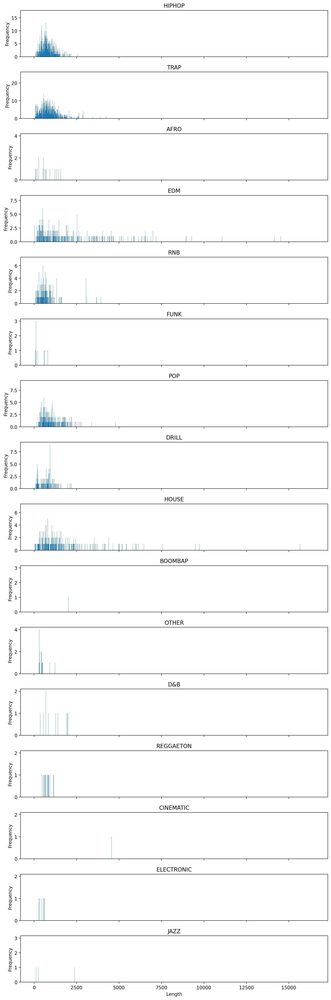

In [34]:
import pandas as pd
import matplotlib.pyplot as plt


# Convert dictionary to a DataFrame
df = pd.DataFrame([(genre, value) for genre, values in len_piece.items() for value in values], columns=['Genre', 'Length'])

# Plot histograms
genres = df['Genre'].unique()
num_genres = len(genres)
fig, axes = plt.subplots(num_genres, 1, figsize=(10, 30), sharex=True)

for i, genre in enumerate(genres):
    ax = axes[i]
    df[df['Genre'] == genre]['Length'].plot(kind='hist', bins=range(int(df['Length'].min()), int(df['Length'].max())), ax=ax, legend=False, title=genre)
    #df[df['Genre'] == genre]['Value'].hist(ax=ax)
    ax.set_xlabel('Length')
    ax.set_ylabel('Frequency')

plt.tight_layout()
plt.show()

In [ ]:
import re


from tqdm import tqdm
genres = {}
with open('output.txt') as f:
    content = f.readlines()
    
for line in content:
    genre = line.split()[1].split('=')[1]
    if genre not in genres:
        genres[genre] = []
    genres[genre].append(line)
    
len_delta = {genre : [] for genre in genres.keys()}

for genre in genres:
    for line in tqdm(genres[genre]):
        for track in line.split('TRACK_START')[1:]:
            len_delta[genre].append(sum_time_deltas(track))
            if sum_time_deltas(track) == 0:
                print(track)


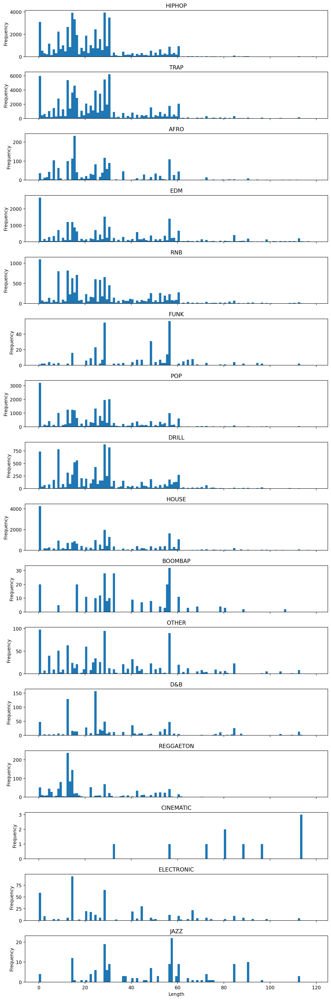

In [38]:
import pandas as pd
import matplotlib.pyplot as plt


# Convert dictionary to a DataFrame
df = pd.DataFrame([(genre, value) for genre, values in len_delta.items() for value in values], columns=['Genre', 'Length'])

# Plot histograms
genres = df['Genre'].unique()
num_genres = len(genres)
fig, axes = plt.subplots(num_genres, 1, figsize=(10, 30), sharex=True)

for i, genre in enumerate(genres):
    ax = axes[i]
    df[df['Genre'] == genre]['Length'].plot(kind='hist', bins=range(int(df['Length'].min()), int(df['Length'].max())), ax=ax, legend=False, title=genre)
    #df[df['Genre'] == genre]['Value'].hist(ax=ax)
    ax.set_xlabel('Length')
    ax.set_ylabel('Frequency')

plt.tight_layout()
plt.show()

In [5]:
from tqdm import tqdm
genres = {}
with open('output_nodup.txt') as f:
    content = f.readlines()
    
for line in content:
    genre = line.split()[1].split('=')[1]
    if genre not in genres:
        genres[genre] = []
    genres[genre].append(line)
    


# Push to HF

## Push Augmented

In [4]:
!huggingface-cli login 


Token will not been saved to git credential helper. Pass `add_to_git_credential=True` if you want to set the git credential as well.
Token is valid (permission: write).
Your token has been saved to /Users/adamzinebi/.cache/huggingface/token
Login successful


In [48]:
from datasets import Dataset, DatasetDict
import pandas as pd
from huggingface_hub import HfApi, login

# Step 1: Read the text file
file_path = 'Augmented_FLP.txt'
with open(file_path, 'r') as file:
    data = file.readlines()
    
nd = []

for line in data:
    nd.append(line.replace('\n',''))

# Step 2: Convert to a pandas DataFrame
df = pd.DataFrame(nd, columns=['text'])

# Step 3: Convert to Hugging Face Dataset
dataset = Dataset.from_pandas(df)

# Optional: Split dataset if needed (e.g., train/test/validation)
# Here we'll just create a simple dataset dictionary with a train split
dataset_dict = DatasetDict({
    'train': dataset
})





In [51]:
dataset_dict.push_to_hub("beatson/AuGmented_FLP_Dataset")

Uploading the dataset shards:   0%|          | 0/8 [00:02<?, ?it/s]

Creating parquet from Arrow format:   0%|          | 0/56 [00:00<?, ?ba/s]

Creating parquet from Arrow format:   0%|          | 0/56 [00:00<?, ?ba/s]

Creating parquet from Arrow format:   0%|          | 0/56 [00:00<?, ?ba/s]

Creating parquet from Arrow format:   0%|          | 0/56 [00:00<?, ?ba/s]

Creating parquet from Arrow format:   0%|          | 0/56 [00:00<?, ?ba/s]

Creating parquet from Arrow format:   0%|          | 0/56 [00:00<?, ?ba/s]

Creating parquet from Arrow format:   0%|          | 0/56 [00:00<?, ?ba/s]

Creating parquet from Arrow format:   0%|          | 0/56 [00:00<?, ?ba/s]

## Push Small

In [52]:

from datasets import Dataset, DatasetDict
import pandas as pd
from huggingface_hub import HfApi, login

# Step 1: Read the text file
file_path = 'last_re_nd.txt'
with open(file_path, 'r') as file:
    data = file.readlines()

nd = []

for line in data:
    nd.append(line.replace('\n',''))
    
# Step 2: Convert to a pandas DataFrame
df = pd.DataFrame(nd, columns=['text'])

# Step 3: Convert to Hugging Face Dataset
dataset = Dataset.from_pandas(df)

# Optional: Split dataset if needed (e.g., train/test/validation)
# Here we'll just create a simple dataset dictionary with a train split
dataset_dict = DatasetDict({
    'train': dataset
})





In [54]:
print(dataset_dict['train']['text'][0])
dataset_dict

PIECE_START GENRE=HIPHOP TRACK_START INST=3 BAR_START NOTE_ON=33 NOTE_ON=62 NOTE_ON=45 TIME_DELTA=1 NOTE_ON=60 TIME_DELTA=1 NOTE_OFF=62 NOTE_ON=64 TIME_DELTA=1 NOTE_OFF=60 NOTE_ON=60 TIME_DELTA=1 NOTE_OFF=64 NOTE_ON=69 TIME_DELTA=1 NOTE_OFF=60 NOTE_ON=60 TIME_DELTA=1 NOTE_OFF=69 NOTE_ON=67 TIME_DELTA=1 NOTE_OFF=60 NOTE_ON=60 TIME_DELTA=1 NOTE_OFF=67 NOTE_ON=65 TIME_DELTA=1 NOTE_OFF=60 NOTE_ON=60 TIME_DELTA=1 NOTE_OFF=65 NOTE_ON=64 TIME_DELTA=1 NOTE_OFF=60 NOTE_ON=60 TIME_DELTA=1 NOTE_OFF=64 NOTE_ON=62 TIME_DELTA=1 NOTE_OFF=60 NOTE_ON=60 TIME_DELTA=1 NOTE_OFF=62 NOTE_ON=64 TIME_DELTA=1 NOTE_OFF=60 NOTE_ON=60 BAR_END BAR_START NOTE_OFF=33 NOTE_OFF=45 NOTE_OFF=64 NOTE_ON=31 NOTE_ON=43 NOTE_ON=62 TIME_DELTA=1 NOTE_OFF=60 NOTE_ON=60 TIME_DELTA=1 NOTE_OFF=62 NOTE_ON=64 TIME_DELTA=1 NOTE_OFF=60 NOTE_ON=60 TIME_DELTA=1 NOTE_OFF=64 NOTE_ON=69 TIME_DELTA=1 NOTE_OFF=60 NOTE_ON=60 TIME_DELTA=1 NOTE_OFF=69 NOTE_ON=67 TIME_DELTA=1 NOTE_OFF=60 NOTE_ON=60 TIME_DELTA=1 NOTE_OFF=67 NOTE_ON=65 TIME_DELTA

DatasetDict({
    train: Dataset({
        features: ['text'],
        num_rows: 19110
    })
})

In [55]:
dataset_dict.push_to_hub("beatson/Small_FLP_Dataset")

Uploading the dataset shards:   0%|          | 0/1 [00:00<?, ?it/s]

Creating parquet from Arrow format:   0%|          | 0/20 [00:00<?, ?ba/s]